## Import and data loading

In [1]:
import pandas as pd
import numpy as np

In [2]:
from IPython.display import display, HTML
display(HTML("<style>.container { width:100% !important; }</style>"))
pd.set_option('display.max_rows', 50000)
pd.set_option('display.max_columns', 50000)
pd.set_option('display.width', 100000)


In [3]:
#import plotly.go
import matplotlib.pyplot as plt
import plotly.graph_objects as go
from plotly.subplots import make_subplots


In [4]:
data_0 = pd.read_csv(r'C:\Users\ayush\Desktop\IITB\IMCP_2\round-3-island-data-bottle\prices_round_3_day_0.csv', sep=';')
data_1 = pd.read_csv(r'C:\Users\ayush\Desktop\IITB\IMCP_2\round-3-island-data-bottle\prices_round_3_day_1.csv', sep=';')
data_2 = pd.read_csv(r'C:\Users\ayush\Desktop\IITB\IMCP_2\round-3-island-data-bottle\prices_round_3_day_2.csv', sep=';')


In [5]:
data_0.head()

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss
0,0,0,CHOCOLATE,7999,111,NaN,NaN,NaN,NaN,8001,111,NaN,NaN,NaN,NaN,8000.0,0.0
1,0,0,STRAWBERRIES,3999,210,NaN,NaN,NaN,NaN,4001,210,NaN,NaN,NaN,NaN,4000.0,0.0
2,0,0,ROSES,14999,72,NaN,NaN,NaN,NaN,15001,72,NaN,NaN,NaN,NaN,15000.0,0.0
3,0,0,GIFT_BASKET,71348,19,71347.0,24.0,NaN,NaN,71362,19,71363.0,24.0,NaN,NaN,71355.0,0.0
4,0,100,GIFT_BASKET,71344,1,71343.0,12.0,71342.0,20.0,71355,1,71356.0,12.0,71357.0,20.0,71349.5,0.0


In [6]:
## plot using plotly
data = pd.concat([data_0, data_1, data_2
                  ], axis=0)

data['timestamp'] += data['day'] * 1e6

In [7]:
data_choco = data[data['product'] == 'CHOCOLATE']
data_straw = data[data['product'] == 'STRAWBERRIES']
data_rose = data[data['product'] == 'ROSES']
data_gift = data[data['product'] == 'GIFT_BASKET']

In [8]:
def add_spread(data):
    data['spread'] = data['ask_price_1'] - data['bid_price_1']
    data.reset_index(drop=True, inplace=True)
add_spread(data_straw)
add_spread(data_straw)
add_spread(data_rose)
add_spread(data_gift)

data_choco.reset_index(drop=True, inplace=True)
data_straw.reset_index(drop=True, inplace=True)
data_rose.reset_index(drop=True, inplace=True)
data_gift.reset_index(drop=True, inplace=True)

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\3701408055.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['spread'] = data['ask_price_1'] - data['bid_price_1']
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\3701408055.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['spread'] = data['ask_price_1'] - data['bid_price_1']
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\3701408055.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using

In [9]:
data_gift['spread'].describe()

count    30000.000000
mean        10.864000
std          2.377062
min          1.000000
25%         11.000000
50%         11.000000
75%         13.000000
max         14.000000
Name: spread, dtype: float64

In [10]:
data_gift['valuation'] = 4 * data_choco['mid_price'] + 6 * data_straw['mid_price'] + data_rose['mid_price'] 

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\1385181905.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_gift['valuation'] = 4 * data_choco['mid_price'] + 6 * data_straw['mid_price'] + data_rose['mid_price']


In [11]:
data_gift['diff'] = data_gift['mid_price'] - data_gift['valuation'] 

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\3593430086.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_gift['diff'] = data_gift['mid_price'] - data_gift['valuation']


In [12]:
data_gift['diff'].describe()

count    30000.000000
mean       379.490483
std         76.424382
min        140.000000
25%        329.000000
50%        381.000000
75%        430.000000
max        632.000000
Name: diff, dtype: float64

In [13]:
data_straw['valuation'] =  (data_gift['mid_price'] - 4 * data_choco['mid_price'] - data_rose['mid_price'])/6
data_straw['delta'] = data_straw['mid_price'] - data_straw['valuation']
data_straw['pressure'] = data_straw['ask_volume_1'] - data_straw['bid_volume_1']

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\533172625.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_straw['valuation'] =  (data_gift['mid_price'] - 4 * data_choco['mid_price'] - data_rose['mid_price'])/6
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\533172625.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_straw['delta'] = data_straw['mid_price'] - data_straw['valuation']
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\533172625.py:3: SettingWithCopyWarning: 
A value is tryin

In [14]:
data_rose['valuation'] =  (data_gift['mid_price'] - 4 * data_choco['mid_price'] - 6 * data_straw['mid_price'])
data_rose['delta'] = data_rose['mid_price'] - data_rose['valuation']    
data_rose['pressure'] = data_rose['ask_volume_1'] - data_rose['bid_volume_1']

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\870002288.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_rose['valuation'] =  (data_gift['mid_price'] - 4 * data_choco['mid_price'] - 6 * data_straw['mid_price'])
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\870002288.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data_rose['delta'] = data_rose['mid_price'] - data_rose['valuation']
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\870002288.py:3: SettingWithCopyWarning: 
A value is trying

In [15]:
data_rose['pressure'].describe()
data_rose.head(30)

,day,timestamp,product,bid_price_1,bid_volume_1,bid_price_2,bid_volume_2,bid_price_3,bid_volume_3,ask_price_1,ask_volume_1,ask_price_2,ask_volume_2,ask_price_3,ask_volume_3,mid_price,profit_and_loss,spread,valuation,delta,pressure
0,0,0.0,ROSES,14999,72,NaN,NaN,NaN,NaN,15001,72,NaN,NaN,NaN,NaN,15000.0,0.0,2,15355.0,-355.0,0
1,0,100.0,ROSES,14999,66,NaN,NaN,NaN,NaN,15001,66,NaN,NaN,NaN,NaN,15000.0,0.0,2,15346.5,-346.5,0
2,0,200.0,ROSES,15000,61,NaN,NaN,NaN,NaN,15001,21,15002.0,40.0,NaN,NaN,15000.5,0.0,1,15346.0,-345.5,-40
3,0,300.0,ROSES,14999,69,NaN,NaN,NaN,NaN,15001,69,NaN,NaN,NaN,NaN,15000.0,0.0,2,15343.5,-343.5,0
4,0,400.0,ROSES,14997,62,NaN,NaN,NaN,NaN,14998,62,NaN,NaN,NaN,NaN,14997.5,0.0,1,15336.5,-339.0,0
5,0,500.0,ROSES,14996,30,14995.0,35.0,NaN,NaN,14997,65,NaN,NaN,NaN,NaN,14996.5,0.0,1,15340.5,-344.0,35
6,0,600.0,ROSES,14993,67,NaN,NaN,NaN,NaN,14994,67,NaN,NaN,NaN,NaN,14993.5,0.0,1,15343.5,-350.0,0
7,0,700.0,ROSES,14993,56,NaN,NaN,NaN,NaN,14994,56,NaN,NaN,NaN,NaN,14993.5,0.0,1,15338.5,-345.0,0
8,0,800.0,ROSES,14997,30,14996.0,42.0,NaN,NaN,14998,72,NaN,NaN,NaN,NaN,14997.5,0.0,1,15342.5,-345.0,42
9,0,900.0,ROSES,14995,67,NaN,NaN,NaN,NaN,14997,67,NaN,NaN,NaN,NaN,14996.0,0.0,2,15339.5,-343.5,0


## Helper functions


In [16]:
import talib as ta

def add_indicators(data):

    data['sma_5'] = ta.SMA(data['mid_price'], timeperiod=5) - data['mid_price']
    data['sma_10'] = ta.SMA(data['mid_price'], timeperiod=10) - data['mid_price']
    data['sma_20'] = ta.SMA(data['mid_price'], timeperiod=20) - data['mid_price']
    data['sma_50'] = ta.SMA(data['mid_price'], timeperiod=50) - data['mid_price']
    data['sma_100'] = ta.SMA(data['mid_price'], timeperiod=100) - data['mid_price']
    data['sma_200'] = ta.SMA(data['mid_price'], timeperiod=200) - data['mid_price']
    data['ema_5'] = ta.EMA(data['mid_price'], timeperiod=5) - data['mid_price']
    data['ema_10'] = ta.EMA(data['mid_price'], timeperiod=10) - data['mid_price']
    data['ema_20'] = ta.EMA(data['mid_price'], timeperiod=20) - data['mid_price']
    data['ema_50'] = ta.EMA(data['mid_price'], timeperiod=50) - data['mid_price']
    data['ema_100'] = ta.EMA(data['mid_price'], timeperiod=100) - data['mid_price']
    data['ema_200'] = ta.EMA(data['mid_price'], timeperiod=200) - data['mid_price']
    data['rsi'] = ta.RSI(data['mid_price'], timeperiod=14)
    data['macd'], data['macd_signal'], data['macd_hist'] = ta.MACD(data['mid_price'])
    data['macd_signal'] = data['macd_signal']
    data['macd_hist'] = data['macd_hist']
    data['macd_diff'] = data['macd'] - data['macd_signal']

add_indicators(data_gift)
add_indicators(data_straw)
add_indicators(data_straw)
add_indicators(data_rose)
    

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\2434221694.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['sma_5'] = ta.SMA(data['mid_price'], timeperiod=5) - data['mid_price']
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\2434221694.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  data['sma_10'] = ta.SMA(data['mid_price'], timeperiod=10) - data['mid_price']
C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\2434221694.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of

In [17]:
def calculate_macd(df, fast_period=3, slow_period=99, signal_period=2):
    # Calculate the short-term exponential moving average (EMA)
    ema_fast = df['mid_price'].ewm(span=fast_period).mean()
    
    # Calculate the long-term exponential moving average (EMA)
    ema_slow = df['mid_price'].ewm(span=slow_period).mean()
    
    # Calculate the MACD line
    macd_line = ema_fast - ema_slow
    
    # Calculate the signal line
    signal_line = macd_line.ewm(span=signal_period).mean()
    
    # Calculate the MACD histogram
    macd_hist = macd_line - signal_line
    
    df['macd_line'] = macd_line
    df['signal_line'] = signal_line
    df['macd_hist'] = macd_hist

    return df

In [18]:
def plot_sunlight_humidity_orchids(data):
    fig = go.Figure()

    # Add SUNLIGHT trace
    fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bid_price_1'], name='bid_price_1'))

    # Add HUMIDITY trace
    fig.add_trace(go.Scatter(x=data['timestamp'], y=data['bid_price_2'], name='bid_price_2'))

    # Add ORCHIDS trace
    fig.add_trace(go.Scatter(x=data['timestamp'], y=data['ask_price_1'], name='ask_price_1'))

    # Add export target trace   
    fig.add_trace(go.Scatter(x=data['timestamp'], y=data['ask_price_2'], name='ask_price_2'))

    # fig.add_trace(go.Scatter(x=data['timestamp'], y=data['IMPORT_TARIFF'], name='IMPORT_TARIFF', yaxis='y5'))

    # Update layout
    fig.update_layout(title='Sunlight, Humidity, and Orchids',
                    xaxis_title='Timestamp',
                    yaxis=dict(title='SUNLIGHT', side='left'))
                    

    # Show the plot
    fig.show()

plot_sunlight_humidity_orchids(data_rose)

In [19]:
plot_sunlight_humidity_orchids(data_straw)
plot_sunlight_humidity_orchids(data_gift)
plot_sunlight_humidity_orchids(data_choco)

In [20]:
def print_corrs(df, alphas, rets = ['ret_10', 'ret_30', 'ret_300', 'ret_5']):
# def print_corrs(df, alphas, rets = ['ret_10', 'ret_30', 'iv_10']):
# def print_corrs(df, alphas, rets = ['tick_10', 'tick_30', 'tick_60', 'tick_300']):
# def print_corrs(df, alphas, rets = ['ret_60', 'ret_300', 'iv_60']):
    msg = "                                      "
    for ret in rets:
        msg += f"{ret:>8s}"
    print(msg)
    for alpha in alphas:
        msg = f"{alpha:30s} corr -> "
        for ret in rets:
            msg += f"{df[alpha].corr(df[ret])*100:7.2f} "
        print(msg)
    print()

In [21]:
def print_buckets(df, alphas, rets = ['ret_10', 'ret_5', 'ret_30', 'ret_300'], aggfunc = ['mean', 'median', 'count'], buckets = 5):
# def print_buckets(df, alphas, rets = ['ret_10', 'ret_30', 'iv_10'], aggfunc = ['mean', 'median', 'count']):
# def print_buckets(df, alphas, rets = ['tick_10', 'tick_30', 'tick_60', 'tick_300'], aggfunc = ['mean', 'median', 'count']):
# def print_buckets(df, alphas, rets = ['ret_60', 'ret_300', 'iv_60'], aggfunc = ['mean', 'median', 'count']):
    for alpha in alphas:
        msg = df.pivot_table(index = pd.qcut(df[alpha],buckets,duplicates='drop'), values=rets, aggfunc=aggfunc)
        print(msg)

In [22]:
def add_ret(df, periods = [1, 5, 10, 30, 60, 300]):
    for period in periods:
        df[f'ret_{period}'] = df['mid_price'].pct_change(period).shift(-period) * 1e4
    return df
df = add_ret(data_gift)
_ = add_ret(data_straw)
_ = add_ret(data_straw)
_ = add_ret(data_rose)

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\704066862.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\704066862.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\704066862.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-d

In [23]:
indicators = ['sma_5', 'sma_10', 'sma_20', 'sma_50', 'sma_100', 'sma_200', 'ema_5', 'ema_10', 'ema_20', 'ema_50', 'ema_100', 'ema_200', 'rsi', 'macd', 'macd_signal', 'macd_hist', 'macd_diff']
print_corrs(data_rose, indicators)

                                        ret_10  ret_30 ret_300   ret_5
sma_5                          corr ->   -0.44   -0.98   -0.60   -0.95 
sma_10                         corr ->   -0.49   -1.07   -0.83   -0.72 
sma_20                         corr ->   -0.75   -0.60   -1.20   -0.77 
sma_50                         corr ->   -0.05    1.72   -1.54   -0.32 
sma_100                        corr ->    1.45    3.23   -2.73    0.83 
sma_200                        corr ->    0.39    0.93   -2.61    0.20 
ema_5                          corr ->   -0.48   -1.01   -0.72   -0.89 
ema_10                         corr ->   -0.63   -0.90   -1.00   -0.85 
ema_20                         corr ->   -0.65   -0.12   -1.39   -0.77 
ema_50                         corr ->    0.23    1.67   -2.10   -0.08 
ema_100                        corr ->    0.52    1.82   -2.67    0.18 
ema_200                        corr ->    0.23    0.94   -1.22    0.06 
rsi                            corr ->    0.80   -0.29    2.04   

In [24]:
data_rose['delta'].describe()

count    30000.000000
mean      -379.490483
std         76.424382
min       -632.000000
25%       -430.000000
50%       -381.000000
75%       -329.000000
max       -140.000000
Name: delta, dtype: float64

In [25]:
print_corrs(data_rose, ['delta', 'pressure'], )
print_buckets(data_rose, ['delta', 'pressure'], buckets = 6)

                                        ret_10  ret_30 ret_300   ret_5
delta                          corr ->   -0.27   -0.74   -3.00   -0.17 
pressure                       corr ->   -1.57   -0.62   -0.98   -2.18 

                        mean                                  median                                count                     
                      ret_10    ret_30   ret_300     ret_5    ret_10    ret_30   ret_300     ret_5 ret_10 ret_30 ret_300 ret_5
delta                                                                                                                         
(-632.001, -454.0]  0.033744  0.038708 -0.530096  0.028525  0.000000  0.000000  0.000000  0.000000   5042   5042    5042  5042
(-454.0, -411.5]   -0.235610 -0.691115 -3.127728 -0.077620  0.000000  0.000000 -3.818251  0.000000   4967   4967    4931  4967
(-411.5, -381.0]   -0.352388 -0.859350 -7.668117 -0.239029 -0.350680 -1.355519 -6.783110 -0.342959   5035   5035    5023  5035
(-381.0, -347.5]   -0.

In [26]:
print_corrs(data_straw, ['delta'])
print_buckets(data_straw, ['delta'], buckets=8)

                                        ret_10  ret_30 ret_300   ret_5
delta                          corr ->    3.24    5.93   10.08    1.92 

                         mean                               median                            count                     
                       ret_10    ret_30   ret_300     ret_5 ret_10    ret_30   ret_300 ret_5 ret_10 ret_30 ret_300 ret_5
delta                                                                                                                   
(-105.334, -78.417] -0.083394 -0.149885  2.915522 -0.025213    0.0  0.000000  2.512247   0.0   3755   3755    3755  3755
(-78.417, -71.667]  -0.332909 -1.074188 -4.033342 -0.157923    0.0 -1.236247 -4.952640   0.0   3771   3771    3752  3771
(-71.667, -67.333]  -0.152252 -0.344128 -4.161326 -0.094686    0.0  0.000000 -4.930359   0.0   3781   3781    3759  3781
(-67.333, -63.5]    -0.058626 -0.307365 -3.508463 -0.031438    0.0  0.000000 -3.727403   0.0   3737   3737    3730  3737
(-63.5, -

In [27]:
print_corrs(df, ['mid_price', 'spread', 'diff'])
print_buckets(df, ['mid_price', 'spread', 'diff'])

                                        ret_10  ret_30 ret_300   ret_5
mid_price                      corr ->   -1.05   -1.61   -5.43   -0.74 
spread                         corr ->    1.01    0.54    0.30    0.20 
diff                           corr ->  -10.27  -17.21  -42.21   -7.41 

                          mean                                  median                                count                     
                        ret_10    ret_30   ret_300     ret_5    ret_10    ret_30   ret_300     ret_5 ret_10 ret_30 ret_300 ret_5
mid_price                                                                                                                       
(69344.499, 69917.0]  0.037331  0.026607 -0.160144  0.019826  0.071555  0.071916 -2.576324  0.000000   5996   5976    5706  6001
(69917.0, 70801.5]   -0.177676 -0.455079 -6.117996 -0.085565 -0.214440 -0.428532 -5.390644 -0.141534   6009   6009    6009  6009
(70801.5, 71022.5]    0.069822  0.137267  3.933176  0.034673  0.070

## Analysing plots

In [28]:
data_choco['diff'] = data_gift['diff']
data_straw['diff'] = data_gift['diff']
data_rose['diff'] = data_gift['diff']

print_corrs(data_straw, ['diff'])
print_corrs(data_straw, ['diff'])
print_corrs(data_rose, ['diff'])


print_buckets(data_straw, ['diff'])
print_buckets(data_straw, ['diff'])
print_buckets(data_rose, ['diff'])

                                        ret_10  ret_30 ret_300   ret_5
diff                           corr ->   -3.24   -5.93  -10.08   -1.92 

                                        ret_10  ret_30 ret_300   ret_5
diff                           corr ->   -3.24   -5.93  -10.08   -1.92 

                                        ret_10  ret_30 ret_300   ret_5
diff                           corr ->    0.27    0.74    3.00    0.17 



C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\1043841687.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\1043841687.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\1043841687.py:3: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

                      mean                               median                         count                     
                    ret_10    ret_30   ret_300     ret_5 ret_10 ret_30   ret_300 ret_5 ret_10 ret_30 ret_300 ret_5
diff                                                                                                              
(139.999, 316.5]  0.104191  0.431956  4.820357  0.033308    0.0    0.0  3.756574   0.0   6012   5992    5847  6017
(316.5, 361.0]    0.181047  0.376266 -0.077337  0.129060    0.0    0.0  1.241696   0.0   6008   6008    5938  6008
(361.0, 399.5]   -0.021277 -0.009368 -2.735853 -0.044452    0.0    0.0 -3.694809   0.0   6026   6026    6014  6026
(399.5, 442.5]   -0.180995 -0.520288 -4.365283 -0.101106    0.0    0.0 -4.960625   0.0   5965   5965    5930  5965
(442.5, 632.0]   -0.145585 -0.477262  0.646146 -0.048790    0.0    0.0  0.000000   0.0   5979   5979    5971  5979
                      mean                               median                 

## MACD params on each of the indivisual elements

In [29]:
def calculate_max_corr(df):
    max_corr = -2
    max_period = ()
    for fast_period in range(24, 50):
        for slow_period in range(40, 80):
            for signal_period in range(20, 40):
                df_macd = calculate_macd(df, fast_period, slow_period, signal_period)
                corr = df_macd['macd_hist'].corr(df_macd['ret_10'])
                if corr > max_corr:
                    max_corr = corr
                    max_period = (fast_period, slow_period, signal_period)
                
    return max_corr, max_period

In [30]:
calculate_max_corr(data_straw)

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\553696339.py:17: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\553696339.py:18: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\553696339.py:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/panda

(0.004342290935084363, (30, 40, 30))

In [31]:
# data_straw/.head()

In [32]:
# import matplotlib.pyplot as plt

# # Sample data
# x = data_straw['timestamp']
# y = data_straw['mid_price']

# # Calculate differences between consecutive points
# diff = data_straw['diff']

# # Create the plot
# plt.figure(figsize=(10, 6))
# plt.plot(x, y, linestyle='-', color='b')

# # Mark the regions where the difference is greater than 500 and smaller than 200
# for i in range(len(diff)):
#     if diff[i] < -500:
#         plt.axvspan(x[i], x[i+1], color='red', alpha=0.3)
#     elif diff[i] > -350:
#         plt.axvspan(x[i], x[i+1], color='green', alpha=0.3)

# plt.xlabel('X-axis')
# plt.ylabel('Difference')
# plt.title('Difference Plot')
# plt.grid(True)
# plt.show()

In [ ]:
len(data_straw)

10000

In [34]:
data_straw['delta_diff'] = data_straw['diff'] - data_straw['diff'].shift(1)
data_straw['change'] = data_straw['mid_price'] - data_straw['mid_price'].shift(1)

data_straw['change'][0] = 0
data_straw['delta_diff'][0] = 0

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\412386934.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\412386934.py:2: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\412386934.py:4: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-vers

In [35]:
data_straw['delta_diff'].describe()

count    30000.000000
mean        -0.003917
std          6.246369
min        -23.000000
25%         -4.000000
50%          0.000000
75%          4.000000
max         27.500000
Name: delta_diff, dtype: float64

In [36]:
data_straw['delta_diff'].corr(data_straw['change'])

-0.117562721600801

In [37]:
df = data_straw
msg = df.pivot_table(index = pd.qcut(df['delta_diff'], 10,duplicates='drop'), values=['change'], aggfunc=['mean'])
print(msg)

                     mean
                   change
delta_diff               
(-23.001, -8.0]  0.081252
(-8.0, -5.0]     0.055461
(-5.0, -3.0]     0.031270
(-3.0, -1.5]     0.017420
(-1.5, 0.0]      0.000170
(0.0, 1.5]      -0.006888
(1.5, 3.0]      -0.017667
(3.0, 5.0]      -0.031457
(5.0, 8.0]      -0.059867
(8.0, 27.5]     -0.096334


In [38]:
print_corrs(data_straw, ['delta_diff', 'diff'])
print_buckets(data_straw, ['delta_diff'], buckets = 20)

                                        ret_10  ret_30 ret_300   ret_5
delta_diff                     corr ->    2.81    1.28   -0.16    4.08 
diff                           corr ->   -3.24   -5.93  -10.08   -1.92 

                      mean                               median                         count                     
                    ret_10    ret_30   ret_300     ret_5 ret_10 ret_30   ret_300 ret_5 ret_10 ret_30 ret_300 ret_5
delta_diff                                                                                                        
(-23.001, -10.0] -0.148666 -0.269304 -0.310612 -0.170565    0.0    0.0  0.000000   0.0   1771   1771    1751  1771
(-10.0, -8.0]    -0.148192 -0.021669 -0.269516 -0.138907    0.0    0.0  0.000000   0.0   1471   1471    1452  1472
(-8.0, -6.5]     -0.052057 -0.059973 -0.059594 -0.132705    0.0    0.0  1.226919   0.0   1533   1533    1518  1533
(-6.5, -5.0]     -0.166824 -0.143154 -0.464524 -0.138897    0.0    0.0 -1.232058   0.0   1973 

In [39]:
from scipy.stats import zscore

# Sample data
points = data_straw['mid_price']

# Calculate the z-score using a rolling window of 200 values
z_scores = points.rolling(window=200).apply(lambda x: zscore(x)[-1] if len(x) > 0 else None, raw=True)

# Add the z-scores as a new column in the DataFrame
data_straw['z_scores'] = z_scores


C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\2857926767.py:10: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [40]:
data_straw['z_scores'].describe()

count    29801.000000
mean        -0.036789
std          1.395135
min         -4.058017
25%         -1.174022
50%         -0.066293
75%          1.102659
max          4.365534
Name: z_scores, dtype: float64

In [41]:
data_straw.head()
for i in range(len(data_straw)):
    if data_straw['z_scores'][i] == np.nan:
        data_straw['z_scores'][i] = 0
    print("yes")


yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes
yes


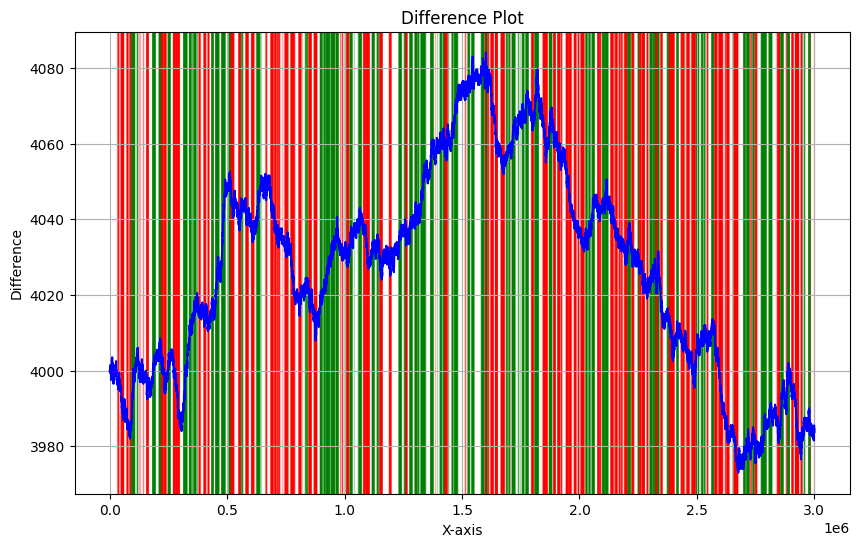

In [42]:
import matplotlib.pyplot as plt

# Sample data
x = data_straw['timestamp']
y = data_straw['mid_price']

# Calculate differences between consecutive points
diff = data_straw['diff']
z_score = data_straw['z_scores']

# Create the plot
plt.figure(figsize=(10, 6))
plt.plot(x, y, linestyle='-', color='b')

# Mark the regions where the difference is greater than 500 and smaller than 200
for i in range(len(diff)):
    if z_score[i] < -2:
        plt.axvspan(x[i], x[i+1], color='red', alpha=0.3)
    elif z_score[i] > 2:
        plt.axvspan(x[i], x[i+1], color='green', alpha=0.3)

plt.xlabel('X-axis')
plt.ylabel('Difference')
plt.title('Difference Plot')
plt.grid(True)
plt.show()

In [43]:
## mark the regions on the xaxis when the diff is greater than 500 and smaller than 200
import plotly.graph_objects as go

# Sample data
x = data_straw['timestamp']
y = data_straw['mid_price']
y2 = data_straw['z_scores']
diff = data_straw['diff']

# Create the figure
fig = go.Figure()

# Add line trace
fig.add_trace(go.Scatter(x=x, y=y, mode='lines', name='choco', yaxis = 'y'))
fig.add_trace(go.Scatter(x= x, y=y2, mode ='lines', name = 'z_score', yaxis = 'y2'))
fig.add_trace(go.Scatter(x=x, y = data_straw['diff'], name = 'diff_gb', yaxis = 'y3'))

# Add horizontal lines
fig.add_shape(type='line', x0=0, x1=max(x), y0=2, y1=2, line=dict(color='blue', width=2), yref='y2')
fig.add_shape(type='line', x0=0, x1=max(x), y0=-2, y1=-2, line=dict(color='red', width=2), yref='y2')

# Update layout
fig.update_layout(yaxis=dict(title='Y-axis 1'),
    yaxis2=dict(title='Y-axis 2', overlaying='y', side='right'),
    yaxis3 = dict(title = 'Y-axis3', overlaying = 'y'))

# Show plot
fig.show()

In [44]:
fig 

In [45]:

x = pd.DataFrame()

x['timestamp'] = data_straw['timestamp']
x['gb'] = data_gift['mid_price']
x['choco'] = data_choco['mid_price']
x['rose'] = data_rose['mid_price']
x['diff'] = data_choco['diff']
x['con'] = 1

y = data_straw['mid_price'].shift(-5)

x2 = x[:10000]
y2 = y[:10000]
## Replace nan values with mean
y = y.fillna(y.mean()) 

In [46]:
## write code to perfrom linear regression 

from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error

# Sample data
x = x[['gb', 'choco', 'rose', 'con', 'diff']]
# y = y['mid_price']

# Create the model
model = LinearRegression()

# Split the data
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.2, random_state=42)

# Train the model
model.fit(x_train, y_train)

# Make predictions
y_pred = model.predict(x_test)

# Calculate the mean squared error
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')



Mean Squared Error: 1.3906347196029796


In [47]:
# Print the weights (coefficients)
weights = model.coef_
print("Weights (Coefficients):", weights)

Weights (Coefficients): [ 0.16653176 -0.66600323 -0.16646411  0.         -0.1668565 ]


In [48]:
# Print the weights (coefficients)
weights = model.coef_
print("Weights (Coefficients): on one day", weights)

Weights (Coefficients): on one day [ 0.16653176 -0.66600323 -0.16646411  0.         -0.1668565 ]


In [49]:
x['alpha'] = 0.16653176*x['gb'] - 0.66600323*x['choco'] - 0.16646411*x['rose']         -0.1668565*x['diff']

In [50]:
data_straw['alpha'] = x['alpha'] - data_straw['mid_price']
print_corrs(data_straw, ['alpha'])

print_buckets(data_straw, ['alpha'],  buckets = 12)

                                        ret_10  ret_30 ret_300   ret_5
alpha                          corr ->    5.40    9.51   24.12    3.58 



C:\Users\ayush\AppData\Local\Temp\ipykernel_12688\2287522588.py:1: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



                      mean                                median                             count                     
                    ret_10    ret_30    ret_300     ret_5 ret_10    ret_30    ret_300 ret_5 ret_10 ret_30 ret_300 ret_5
alpha                                                                                                                  
(-1.509, -1.468] -0.446337 -1.236094  -3.680973 -0.186245    0.0 -1.241465  -2.493921   0.0   2500   2500    2500  2500
(-1.468, -1.458] -0.191606 -0.642390  -5.124036 -0.127130    0.0 -1.229407  -4.929751   0.0   2500   2500    2500  2500
(-1.458, -1.45]  -0.135794 -0.115050  -3.133289 -0.070024    0.0  0.000000  -3.679176   0.0   2500   2500    2500  2500
(-1.45, -1.443]  -0.060225 -0.185774  -1.933273  0.002422    0.0  0.000000  -0.613121   0.0   2500   2500    2500  2500
(-1.443, -1.436]  0.017212 -0.261920  -2.402157 -0.042400    0.0  0.000000   0.000000   0.0   2500   2500    2481  2500
(-1.436, -1.428]  0.202838  0.231522  -4

In [51]:
data_straw['alpha'].describe()

count    30000.000000
mean        -1.421328
std          0.038575
min         -1.507986
25%         -1.450074
50%         -1.427670
75%         -1.397889
max         -1.292353
Name: alpha, dtype: float64